# Structural cereal model

In [23]:
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [24]:
import sys
# caution: path[0] is reserved for script path (or '' in REPL)
sys.path.insert(1, '../src')

In this section, we define a static structural model for cereals.  
The paragraphs are organized so that it is easy to see how the model is built and how we can play on parameters 

## Create a parametric leaf

A parametric leaf is here defined by two sets of coordinates:  
- $(x,y)$ coordinates for the midrib in a vertical plane (origin = leaf base)
- $(s,r)$ parallel array for curviliear abcissa / relative leaf width along leaf shape

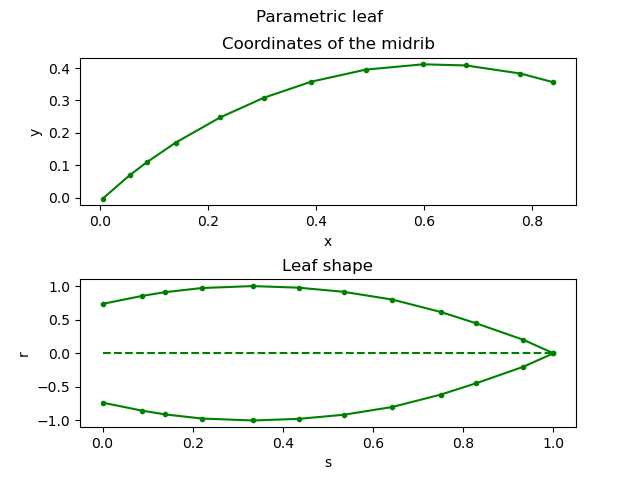

In [25]:
import numpy as np
import matplotlib.pyplot as plt

from heapq import *
from scipy.interpolate import splprep, splev
from scipy.integrate import simps, trapz
from openalea.plantgl.all import Vector3

from cereals_leaf import leaf_shape_perez, sr_prevot, parametric_leaf
# or
# from simple_maize import leaf_shape_perez, sr_prevot, parametric_leaf
# from fitting import leaf_shape_perez

from generator import curvilinear_abscisse

from fitting import fit2, fit3, simplify

from simplification import distance, cost


pl=parametric_leaf(nb_segment=10, insertion_angle=40, scurv=0.7, curvature=70, alpha=-2.3)

fig, (ax1, ax2) = plt.subplots(nrows=2) 
fig.suptitle('Parametric leaf')

ax1.plot(pl[0], pl[1], '.-', c="green")
ax1.set_xlabel('x')
ax1.set_ylabel('y')
ax1.set_title("Coordinates of the midrib")

ax2.plot(pl[2], pl[3], '.-', c="green")
ax2.plot(pl[2], -pl[3], '.-', c="green")
ax2.plot(np.arange(0,1.1,0.1), np.zeros(11), c="green", ls="dashed")
ax2.set_xlabel('s')
ax2.set_ylabel('r')
ax2.set_title("Leaf shape")

plt.subplots_adjust(hspace=0.5)

plt.show()

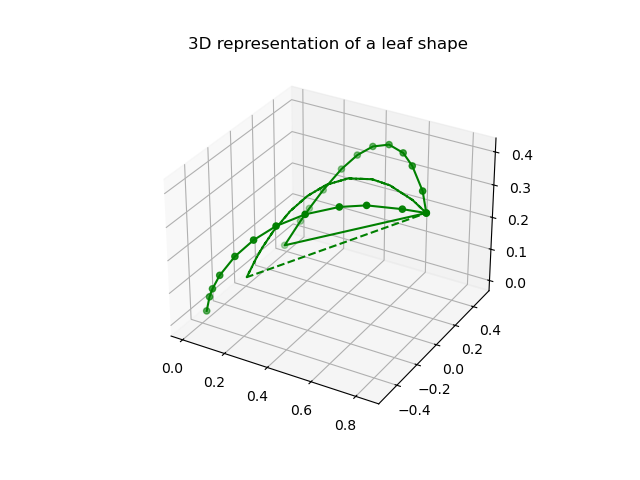

In [26]:
# Enable interactive plotting
%matplotlib ipympl

from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import interp2d
import matplotlib.tri as mtri

from fitting import leaf_to_mesh_2d

xy=pl[0:2]
r=pl[3]

pts,ind=leaf_to_mesh_2d(xy[0], xy[1], r)

xs=[pt[0] for pt in pts]
ys=[pt[1] for pt in pts]
zs=[pt[2] for pt in pts]
    
X,Y=np.meshgrid(xs, ys)

tri = mtri.Triangulation(xs, ys)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(xs,ys,zs,c="green")
ax.plot(xs,ys,zs,c="green")
ax.plot(xs,np.zeros(len(ys)),zs,c="green",ls="dashed")
ax.set_title("3D representation of a leaf shape")
plt.show()


## Generate leaf azimuth series

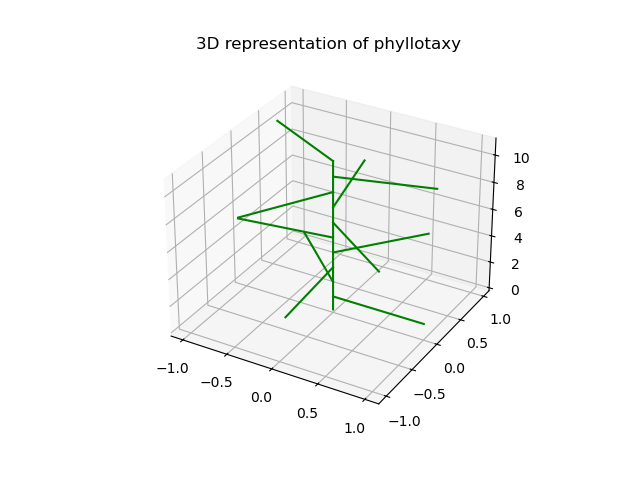

In [27]:
# from itertools import cycle

from plant_design import leaf_azimuth

nb_phy=10
phyllotactic_angle=137
spiral=True
phyllotactic_deviation=0
plant_orientation=0
la=leaf_azimuth(size=nb_phy, phyllotactic_angle=phyllotactic_angle, phyllotactic_deviation=phyllotactic_deviation, plant_orientation=plant_orientation, spiral=spiral)

x = np.cos(la*np.pi/180)
y = np.sin(la*np.pi/180)
z = np.linspace(1,len(la)+1,len(la))

fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))
# ax.scatter(x, y, z, c="green")
for i,a in enumerate(la):
    ax.plot(np.linspace(0,x[i],2), np.linspace(0,y[i],2), [z[i],z[i]], c="green")
ax.plot([0,0], [0,0], [0,z[-1]], c="green")

ax.set_title("3D representation of phyllotaxy")

plt.show()

## Manage internode lengths

In [28]:
def geometric_dist(height, nb_phy, q=1):
    """ returns distances between individual leaves along a geometric model """

    if q == 1:
        u0 = float(height) / nb_phy
    else:
        u0 = height * (1. - q) / (1. - q ** (nb_phy + 1))

    return [u0 * q ** i for i in range(nb_phy)]

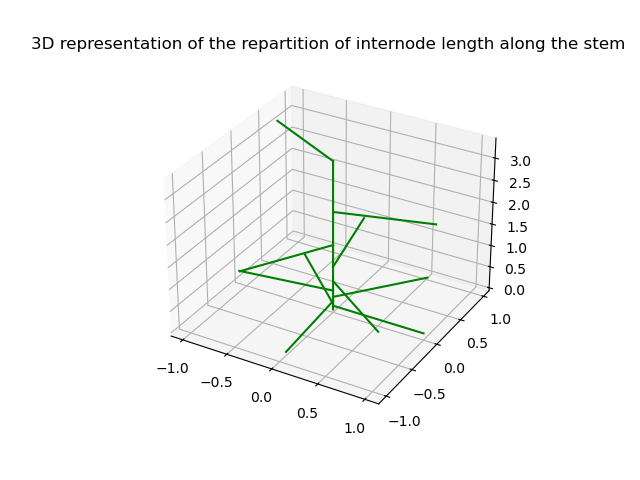

In [29]:
plant_height=15
q=1.5

x = np.cos(la*np.pi/180)
y = np.sin(la*np.pi/180)
z = geometric_dist(height=plant_height, nb_phy=nb_phy, q=q)

fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))
for i,a in enumerate(la):
    ax.plot(np.linspace(0,x[i],2), np.linspace(0,y[i],2), [z[i],z[i]], c="green")
ax.plot([0,0], [0,0], [0,z[-1]], c="green")

ax.set_title("3D representation of the repartition of internode length along the stem")

plt.show()

## Manage leaf lengths as a function of height

In [30]:
def bell_shaped_dist(max_leaf_length, nb_phy, rmax=.7, skew=0.15):
    """ returns leaf area of individual leaves along bell shaped model """

    k = -np.log(skew) * rmax
    r = np.linspace(1. / nb_phy, 1, nb_phy)
    relative_length = np.exp(-k / rmax * (2 * (r - rmax) ** 2 + (r - rmax) ** 3))
    # leaf_length = relative_length / relative_length.sum() * max_leaf_length
    leaf_length = relative_length * max_leaf_length
    return leaf_length.tolist()

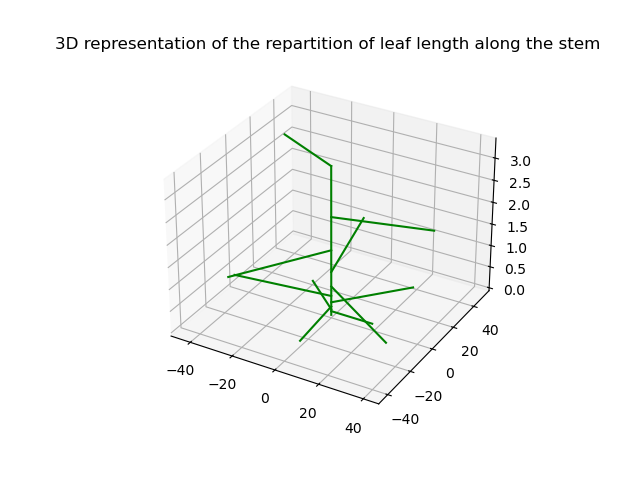

In [31]:
max_leaf_length=50

bsd=bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=.7, skew=0.15)
x = np.cos(la*np.pi/180)*bsd
y = np.sin(la*np.pi/180)*bsd
z = geometric_dist(height=plant_height, nb_phy=nb_phy, q=q)

fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))
for i,a in enumerate(la):
    ax.plot(np.linspace(0,x[i],2), np.linspace(0,y[i],2), [z[i],z[i]], c="green")
ax.plot([0,0], [0,0], [0,z[-1]], c="green")

ax.set_title("3D representation of the repartition of leaf length along the stem")

plt.show()

## Arrange a leaf to be placed along a stem with a given inclination.

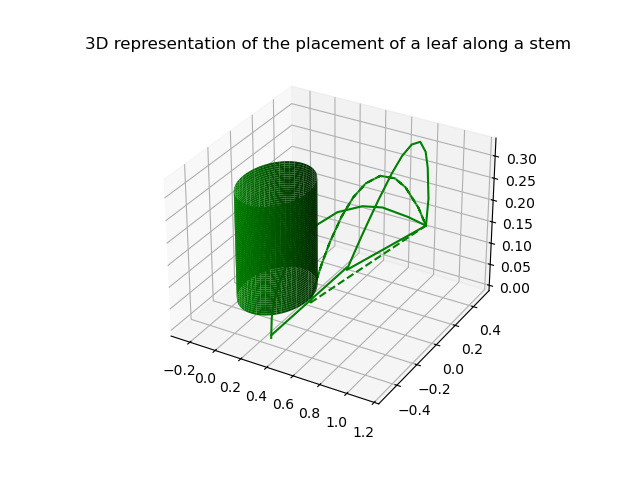

In [32]:
from math import pi, cos, sin, radians
import openalea.plantgl.all as pgl

# from cereals_leaf import arrange_leaf
# or 
from geometry import arrange_leaf

stem_diameter=0.5
inclination=1.2

al=arrange_leaf(leaf=pl, stem_diameter=stem_diameter, inclination=inclination, relative=True)


x=al[0]
y=al[1]
s=al[2]
r=al[3]

pts,ind=leaf_to_mesh_2d(x, y, r)

xs=[pt[0] for pt in pts]
ys=[pt[1] for pt in pts]
zs=[pt[2] for pt in pts]
    
X,Y=np.meshgrid(xs, ys)

tri = mtri.Triangulation(xs, ys)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
# ax.scatter(xs,ys,zs,c="green")
ax.plot(xs,ys,zs,c="green")
ax.plot([xs[0],xs[0]],[ys[0],-ys[0]],[0,0],c="green")
ax.plot(xs,np.zeros(len(ys)),zs,c="green",ls="dashed")

radius=stem_diameter/2
z = np.linspace(0, zs[-1])
theta = np.linspace(0, 2*np.pi)
theta_grid, z_stem=np.meshgrid(theta, z)
x_stem = radius*np.cos(theta_grid)
y_stem = radius*np.sin(theta_grid)

ax.plot_surface(x_stem, y_stem, z_stem, color="green")

ax.set_title("3D representation of the placement of a leaf along a stem")

plt.show()

## Build the whole plant shoot in 3D, as an MTG.

In [33]:
import openalea.plantgl.all as pgl
from openalea.mtg.turtle import TurtleFrame

from geometry import slim_cylinder, stem_mesh, _is_iterable, as_tuples, addSets, leaf_mesh, compute_element
# from cereals_leaf import leaf_mesh
from geometry import CerealsTurtle, CerealsVisitor

from fitting import leaf_element, leaf_to_mesh_2d, leaf_to_mesh, mesh4, plantgl_shape   # leaf_to_mesh_new ?

from openalea.mtg import MTG, fat_mtg
from scipy.interpolate import interp1d
import pandas

from plant_design import get_form_factor, blade_dimension, stem_dimension

from generator import majors_axes_regression, line_projection, as_leaf, as_plant, cereals as cereals_generator

from geometry import mtg_interpreter


def build_shoot(stem_radius, insertion_heights, leaf_lengths, leaf_areas, leaf_azimuths=None, leaf_shapes=None):
    """create a shoot

    Args:
        stem_radius: (float) the stem radius
        insertion_heights: list of each leaf insertion height
        leaf_lengths: list of each leaf length (blade length)
        leaf_areas: list of each blade area
        collar_visible: list of each collar height or True if the collar is visible and False if it is not
        leaf_shapes: list of each leaf shape, if it is not known write None
        leaf_azimuths: list of each leaf azimuth, if it is not known write None

    Returns:
        shoot: 

    """
    ranks = range(1, len(leaf_lengths) + 1)
    ntop = max(ranks) - np.array(ranks) + 1
    if leaf_shapes is None:
        a_leaf = parametric_leaf()
        leaf_shapes = [a_leaf for r in ranks]
    if leaf_azimuths is None:
        leaf_azimuths = leaf_azimuth(len(ranks))
    leaf_azimuths[1:] = np.diff(leaf_azimuths)
    ff = [get_form_factor(leaf) for leaf in leaf_shapes]
    blades = blade_dimension(area=leaf_areas, length=leaf_lengths, ntop=ntop)
    stem = stem_dimension(h_ins=insertion_heights, d_internode=np.array(stem_radius) * 2, ntop=ntop)
    df = blades.merge(stem)
    df['leaf_azimuth'] = leaf_azimuths
    df['leaf_rank'] = ranks
    df['leaf_shape'] = [leaf_shapes[n - 1] for n in df.leaf_rank]
    return df, cereals_generator(plant=df)

In [34]:
def build_shoot_w_pseudo(nb_phy, plant_height, insertion_heights, leaf_lengths, leaf_areas, 
                pseudostem_dist=1.4, stem_dist=1.2,
                diam_base=2.5, diam_top=1, pseudostem_height=20, 
                leaf_azimuths=None, leaf_shapes=None, wl=0.1):
    """create a shoot, with pseudostems and stems

    Args:
        stem_radius: (float) the stem radius
        insertion_heights: list of each leaf insertion height
        leaf_lengths: list of each leaf length (blade length)
        leaf_areas: list of each blade area
        collar_visible: list of each collar height or True if the collar is visible and False if it is not
        leaf_shapes: list of each leaf shape, if it is not known write None
        leaf_azimuths: list of each leaf azimuth, if it is not known write None

    Returns:
        shoot: 

    """
    ranks = range(1, len(leaf_lengths) + 1)
    ntop = max(ranks) - np.array(ranks) + 1

    nb_phy = int(nb_phy)

    # Lejeune an Bernier formula + col =
    nb_young_phy = int(round((nb_phy - 1.95) / 1.84 / 1.3))

    # distances between leaves
    pseudostem = geometric_dist(pseudostem_height, nb_young_phy,
                                pseudostem_dist)
    stem = geometric_dist(plant_height - pseudostem_height,
                          nb_phy - nb_young_phy, stem_dist)
    internode = pseudostem + stem
    # stem diameters
    diameter = ([diam_base] * nb_young_phy +
                np.linspace(diam_base, diam_top,
                            nb_phy - nb_young_phy).tolist())
    
    if leaf_shapes is None:
        a_leaf = parametric_leaf()
        leaf_shapes = [a_leaf for r in ranks]
    if leaf_azimuths is None:
        leaf_azimuths = leaf_azimuth(len(ranks))
    leaf_azimuths[1:] = np.diff(leaf_azimuths)
    ff = [get_form_factor(leaf) for leaf in leaf_shapes]
    # blades = blade_dimension(area=leaf_areas, length=leaf_lengths, ntop=ntop)
    blades = blade_dimension(length=leaf_lengths, form_factor=ff, ntop=ntop, wl=wl)
    # stem = stem_dimension(h_ins=insertion_heights, d_internode=diameter, ntop=ntop)
    stem = stem_dimension(internode=internode, d_internode=diameter, ntop=ntop)
    
    df = blades.merge(stem)
    df['leaf_azimuth'] = leaf_azimuths
    df['leaf_rank'] = ranks
    df['leaf_shape'] = [leaf_shapes[n - 1] for n in df.leaf_rank]
    return df, cereals_generator(plant=df)

# shoot, g = build_shoot(3.0, [2,4,6,8], [2,4,6,8], [2,4,6,8])
# scene, nump = build_scene(g)
# display_scene(scene)

## Display scenes according to different scenarii

### A single cereal

In [35]:
from display import display_mtg, build_scene, display_scene
from oawidgets.plantgl import *
# from oawidgets.mtg import *

%gui qt

# generation of a 3D plant from descritive parameters
stem_radius=1 # realistic, number or growing with phytomer age ?
height=1500 # from crop model
nb_phy=15 # from 0 to fixed max nb of phytomers
max_leaf_length=70
insertion_angle=40
scurv=0.7
curvature=80
phyllotactic_angle=120
spiral=True

insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2)) # further separate stem and pseudo stem, cf simple maize

leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=0.7, skew=0.15)) # plant area --> max leaf length
# leaf_areas=bell_shaped_dist(plant_area=1, nb_phy=15, rmax=0.7, skew=0.15) # cf blade_dimension

a_leaf = parametric_leaf(nb_segment=10, insertion_angle=insertion_angle, scurv=scurv, curvature=curvature, alpha=-2.3)
leaf_shapes = [a_leaf for l in leaf_lengths] # replace leaf_length by nb_phy or...

leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), phyllotactic_angle=phyllotactic_angle, phyllotactic_deviation=15, plant_orientation=0, spiral=spiral)

# shoot, g = build_shoot_w_pseudo(nb_phy=nb_phy, plant_height=height, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None, 
#                 pseudostem_dist=1.4, stem_dist=1.,
#                 diam_base=2.5, diam_top=1, pseudostem_height=20, 
#                 leaf_azimuths=None, leaf_shapes=None)

shoot, g_single = build_shoot(stem_radius=stem_radius, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None,
                leaf_shapes=leaf_shapes, leaf_azimuths=leaf_azimuths)


# g_single.display()

scene_single, nump = build_scene(g_single, leaf_material=Material(Color3((50,100,0))), stem_material=Material(Color3((50,100,0))))
# display_scene(scene_single)
PlantGL(scene_single)

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

['edge_type', 'label', 'length', 'is_green', 'diameter_base', 'diameter_top', 'azimuth', 'shape', 'shape_mature_length', 'visible_length', 'srb', 'srt', 'lrolled', 'd_rolled', 'shape_max_width', 'stem_diameter', 'geometry', 'anchor_point', 'color']


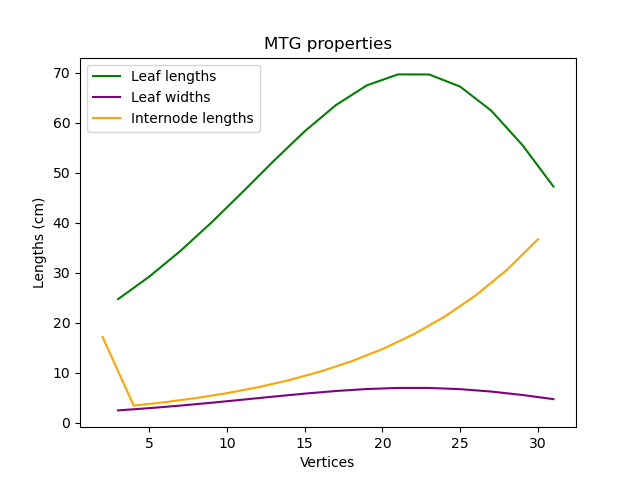

In [36]:
from oawidgets.mtg import *

# Properties on the MTG: this exclude all the topological properties
print(g_single.property_names())

# Retrieve one property for the MTG (dict)

labels = g_single.property('label')
# print(labels)

length = g_single.property('length')
# print(length)

leaf_lengths=[]
leaf_ind=[]
internode_lengths=[]
internode_ind=[]
for k,v in length.items():
    if k%2==0: # could have done it using labels
        internode_ind.append(k)
        internode_lengths.append(v)
    else:
        leaf_ind.append(k)
        leaf_lengths.append(v)

width = g_single.property('shape_max_width')
# print(width)

leaf_widths=[]
for k,v in width.items():
    leaf_widths.append(v)


plt.figure()
plt.plot(leaf_ind, leaf_lengths, c="green", label="Leaf lengths") # == 'shape_mature_length' for final plant
plt.plot(leaf_ind, leaf_widths, c="purple", label="Leaf widths")
plt.plot(internode_ind, internode_lengths, c="orange", label="Internode lengths")
plt.xlabel("Vertices")
plt.ylabel("Lengths (cm)")
plt.title("MTG properties")
plt.legend()
plt.show()


The leaf lengths and widths follow the bell shaped curve described before.  
The first internode in the MTG actually corresponds to the pseudostem, i.e. the about 4 to 8 short first internodes that rapidly lose their leaves. The lengths following internodes follow the geometric model described before.

In [37]:
# classes = list(set(g.class_name(vid) for vid in g.vertices() if g.class_name(vid)))
# print(classes)

# def vertices(g, class_name='P'):
#     return [vid for vid in g.vertices() if g.class_name(vid)==class_name]

# vids_U = vertices(g, 'U')

# plot(g_single, selection=vids_U)

# plot(g_single, selection=[vid for vid in g_single.vertices() if g_single.class_name(vid)=='LeafElement'])

### A cereal crop with variability

In [38]:
from stand import agronomic_plot
from display import display_mtg, build_scene, display_scene
from random import *
from oawidgets.plantgl import *
# from oawidgets.mtg import *

%gui qt

seed(1)

# generation of a crop of 3D plants from descritive parameters with variability
plants_in_crop=[]
length_plot=5
width_plot=5
sowing_density=10
plant_density=10
inter_row=0.5
nplants, positions, domain, domain_area, unit = agronomic_plot(length_plot, width_plot, sowing_density, plant_density, inter_row, noise=0.1)

for n in range(nplants):
    stem_radius=1 # realistic, number or growing with phytomer age ?
    height=1000*(1+random()-0.5) # from crop model
    nb_phy=15 # from 0 to fixed max nb of phytomers
    max_leaf_length=50*(1+random()-0.5)
    insertion_angle=40*(1+random()-0.5)
    scurv=0.7*(1+random()-0.5)
    curvature=70*(1+random()-0.5)
    phyllotactic_angle=137*(1+random()-0.5)
    spiral=True
    
    insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2)) # further separate stem and pseudo stem, cf simple maize
    
    leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=0.7, skew=0.15)) # plant area --> max leaf length
    # leaf_areas=bell_shaped_dist(plant_area=1, nb_phy=15, rmax=0.7, skew=0.15) # cf blade_dimension
    
    a_leaf = parametric_leaf(nb_segment=10, insertion_angle=insertion_angle, scurv=scurv, curvature=curvature, alpha=-2.3)
    leaf_shapes = [a_leaf for l in leaf_lengths] # replace leaf_length by nb_phy or...
    
    leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), phyllotactic_angle=phyllotactic_angle, phyllotactic_deviation=15, plant_orientation=0, spiral=spiral)
    
    # shoot, g = build_shoot_w_pseudo(nb_phy=nb_phy, plant_height=height, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None, 
    #                 pseudostem_dist=1.4, stem_dist=1.,
    #                 diam_base=2.5, diam_top=1, pseudostem_height=20, 
    #                 leaf_azimuths=None, leaf_shapes=None)
    shoot, g_var = build_shoot(stem_radius=stem_radius, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None,
                    leaf_shapes=leaf_shapes, leaf_azimuths=leaf_azimuths)

    plants_in_crop.append(g_var)


scene_var, nump = build_scene(plants_in_crop, positions, leaf_material=Material(Color3((50,100,0))), stem_material=Material(Color3((50,100,0))))
# display_scene(scene_var)
PlantGL(scene_var)

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

### A seemingly growing plant

In [39]:
from stand import agronomic_plot
from display import display_mtg, build_scene, display_scene
from random import *
from openalea.plantgl.all import *
from oawidgets.plantgl import *
# from oawidgets.mtg import *

%gui qt

seed(1)

# generation of ""growing"" 3D plants from descritive parameters
growing_plants=[]
length_plot=1
width_plot=1
sowing_density=10
plant_density=10
inter_row=0.75
# nplants, positions, domain, domain_area, unit = agronomic_plot(length_plot, width_plot, sowing_density, plant_density, inter_row, noise=0.1)
nplants=10
positions=[(x,0,0) for x in range(-500, 500, 100)]
final_height=1000
final_nb_phy=2*nplants
heights=geometric_dist(final_height, final_nb_phy, 1.2)
# insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2))

for n in range(1,nplants+1):
    stem_radius=2 # realistic, number or growing with phytomer age ?
    height=10*heights[2*n-1] # from crop model
    nb_phy=2*n # from 0 to fixed max nb of phytomers
    max_leaf_length=5*2*n
    insertion_angle=30
    scurv=0.7
    curvature=100
    phyllotactic_angle=137
    spiral=True
    
    insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2)) # further separate stem and pseudo stem, cf simple maize
    
    leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=0.7, skew=0.15)) # plant area --> max leaf length
    # leaf_areas=bell_shaped_dist(plant_area=1, nb_phy=15, rmax=0.7, skew=0.15) # cf blade_dimension
    # print(leaf_lengths)
    a_leaf = parametric_leaf(nb_segment=10, insertion_angle=insertion_angle, scurv=scurv, curvature=curvature, alpha=-2.3)
    leaf_shapes = [a_leaf for l in leaf_lengths] # replace leaf_length by nb_phy or...

    leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), phyllotactic_angle=phyllotactic_angle, phyllotactic_deviation=15, plant_orientation=0, spiral=spiral)

    # shoot, g = build_shoot_w_pseudo(nb_phy=nb_phy, plant_height=height, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None, 
    #                 pseudostem_dist=1.4, stem_dist=1.,
    #                 diam_base=2.5, diam_top=1, pseudostem_height=20, 
    #                 leaf_azimuths=None, leaf_shapes=None)
    shoot, g_grow = build_shoot(stem_radius=stem_radius, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None,
                    leaf_shapes=leaf_shapes, leaf_azimuths=leaf_azimuths)

    # print(g_grow)

    growing_plants.append(g_grow)


scene_grow, nump = build_scene(growing_plants[2:], positions[2:], leaf_material=Material(Color3((50,100,0))), stem_material=Material(Color3((50,100,0))))
# display_scene(scene_grow)
PlantGL(scene_grow)

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

### An intercrop organized in rows

In [40]:
from stand import agronomic_plot
from display import display_mtg, build_scene, display_scene
from random import *
from oawidgets.plantgl import *
# from oawidgets.mtg import *
from openalea.plantgl.all import Material, Color3, Shape, Scene, Viewer, Translated, AxisRotated

%gui qt

seed(1)

# generation of 3D intercropped plants from descritive parameters
# plants_in_crop=[]
# length_plot=1
# width_plot=1
# sowing_density=10
# plant_density=10
# inter_row=0.75
# nplants, positions, domain, domain_area, unit = agronomic_plot(length_plot, width_plot, sowing_density, plant_density, inter_row, noise=0.1)
# nplants=10

# final_height=2000
# final_nb_phy=2*nplants
# heights=geometric_dist(final_height, final_nb_phy, 1.2)
# insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2))
def plant(height, nb_phy, max_leaf_length, phyllotactic_angle, spiral):
    stem_radius=1 # realistic, number or growing with phytomer age ?
    insertion_angle=30
    scurv=0.7
    curvature=100
    
    insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2)) # further separate stem and pseudo stem, cf simple maize
    
    leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=0.7, skew=0.15)) # plant area --> max leaf length
    # leaf_areas=bell_shaped_dist(plant_area=1, nb_phy=15, rmax=0.7, skew=0.15) # cf blade_dimension
    
    a_leaf = parametric_leaf(nb_segment=10, insertion_angle=insertion_angle, scurv=scurv, curvature=curvature, alpha=-2.3)
    leaf_shapes = [a_leaf for l in leaf_lengths] # replace leaf_length by nb_phy or...
    
    leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), phyllotactic_angle=phyllotactic_angle, phyllotactic_deviation=15, plant_orientation=0, spiral=spiral)

    # shoot, g = build_shoot_w_pseudo(nb_phy=nb_phy, plant_height=height, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None, 
    #                 pseudostem_dist=1.4, stem_dist=1.,
    #                 diam_base=2.5, diam_top=1, pseudostem_height=20, 
    #                 leaf_azimuths=None, leaf_shapes=None)
    shoot, g = build_shoot(stem_radius=stem_radius, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, leaf_areas=None,
                    leaf_shapes=leaf_shapes, leaf_azimuths=leaf_azimuths)

    return g


### Mixture organized in alternate rows

n_rows = 10
len_rows = 10

d_inter = 70
d_intra = 50

def plant_in_row(i):
     if i%(4*d_inter)==0 or i%(4*d_inter)==d_inter: return plant(height=1700, nb_phy=15, max_leaf_length=100, phyllotactic_angle=137, spiral=True)
     else: return plant(height=900, nb_phy=20, max_leaf_length=40, phyllotactic_angle=60, spiral=True)

# ms=[]

# for x in range(0, n_rows*d_inter, d_inter):
#     for y in range(0, len_rows*d_intra, d_intra):
#         g, col=plant_in_row(x)
#         ts=Translated((x,y,0), g)
#         sh=Shape(ts, col)

#         ms.append(sh)

# scene=Scene(ms)

# Viewer.display(scene)

plants_in_intercrop = [plant_in_row(x) for x in range(0, n_rows*d_inter, d_inter) for y in range(0, len_rows*d_intra, d_intra)]

positions=[(x,y,0) for x in range(0, n_rows*d_inter, d_inter) for y in range(0, len_rows*d_intra, d_intra)]

scene_ic, nump = build_scene(plants_in_intercrop, positions, leaf_material=Material(Color3((50,100,0))), stem_material=Material(Color3((50,100,0))))
# display_scene(scene_ic)
PlantGL(scene_ic)

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

## Tillering / Branching

In [41]:
# Copy MTG single plant
g_branch = g_single.sub_mtg(g_single.root)

# g_branch.display()

# REARRANGE MTG WITH SCALES: PLANT, AXE, METAMER (with internode and leaf), ELEMENTS (StemElements and LeafElements)

In [42]:
# Add branch 

from openalea.mtg import MTG

g = MTG()

plant_id = g.add_component(g.root, label='P1')

# scale 1
v1 = g.add_child(plant_id, label='A1')
v2 = g.add_child(plant_id, label='A2')
v3 = g.add_child(plant_id, label='A3')
v4 = g.add_child(v1, label='I1')
v5 = g.add_child(v1, label='I2')

g.display()

from oawidgets.mtg import *
# plot(g)

MTG : nb_vertices=7, nb_scales=2
/P1			(id=1)											
	/A1			(id=2)										
		/I1			(id=5)									
		/I2			(id=6)									
	/A2			(id=3)										
	/A3			(id=4)										


## Light interception with Caribu

In [43]:
from alinea.caribu.CaribuScene import CaribuScene
from alinea.caribu.data_samples import data_path

sky = str(data_path('Turtle16soc.light'))
# opts = map(str, [data_path('par.opt'), data_path('nir.opt')])

# complete set of files
cs = CaribuScene(scene=scene_var, light=sky) # opt=opts, ) #pattern=pattern)
raw,agg=cs.run(simplify=True)

# print(raw.keys())

scene,values = cs.plot(raw['Ei'],display=False)

v99 = np.percentile(values, 99)
nvalues=np.array(values)
nvalues[nvalues>v99]=v99
values = nvalues.tolist()

PlantGL(scene, group_by_color=False, property=values)


Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

In [44]:
from alinea.caribu.CaribuScene import CaribuScene
from alinea.caribu.data_samples import data_path

sky = str(data_path('Turtle16soc.light'))
# opts = map(str, [data_path('par.opt'), data_path('nir.opt')])

# complete set of files
cs = CaribuScene(scene=scene_ic, light=sky) # opt=opts, ) #pattern=pattern)
raw,agg=cs.run(simplify=True)

scene,values = cs.plot(raw['Ei'],display=False)

v99 = np.percentile(values, 99)
nvalues=np.array(values)
nvalues[nvalues>v99]=v99
values = nvalues.tolist()

PlantGL(scene, group_by_color=False, property=values)


Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

## Next steps:

- Configure Caribu to simulate the same light as in STICS
- Adapt for different species (parameters for cereals, some functions for legumes)